In [1]:
import numpy as np

import pandas as pd
import pandas_profiling

import matplotlib.pyplot as plt
import seaborn as sns
%matplotlib inline

In [2]:
from typing import Tuple

In [3]:
# Read data
df = pd.read_csv('Bias_correction_ucl.csv')

# Explarotary Data Analysis (EDA)

## Data Overview

In [4]:
# First 5 rows of the data
df.head()

,station,Date,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
0,1.0,2013-06-30,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,...,0.0,0.0,0.0,37.6046,126.991,212.3350,2.7850,5992.895996,29.1,21.2
1,2.0,2013-06-30,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,...,0.0,0.0,0.0,37.6046,127.032,44.7624,0.5141,5869.312500,30.5,22.5
2,3.0,2013-06-30,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,...,0.0,0.0,0.0,37.5776,127.058,33.3068,0.2661,5863.555664,31.1,23.9
3,4.0,2013-06-30,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,...,0.0,0.0,0.0,37.6450,127.022,45.7160,2.5348,5856.964844,31.7,24.3
4,5.0,2013-06-30,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,...,0.0,0.0,0.0,37.5507,127.135,35.0380,0.5055,5859.552246,31.2,22.5


In [5]:
# Summary statistics
df.describe()

,station,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,...,LDAPS_PPT2,LDAPS_PPT3,LDAPS_PPT4,lat,lon,DEM,Slope,Solar radiation,Next_Tmax,Next_Tmin
count,7750.000000,7682.000000,7682.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,7677.000000,...,7677.000000,7677.000000,7677.000000,7752.000000,7752.000000,7752.000000,7752.000000,7752.000000,7725.000000,7725.000000
mean,13.000000,29.768211,23.225059,56.759372,88.374804,29.613447,23.512589,7.097875,62.505019,0.368774,...,0.485003,0.278200,0.269407,37.544722,126.991397,61.867972,1.257048,5341.502803,30.274887,22.932220
std,7.211568,2.969999,2.413961,14.668111,7.192004,2.947191,2.345347,2.183836,33.730589,0.262458,...,1.762807,1.161809,1.206214,0.050352,0.079435,54.279780,1.370444,429.158867,3.128010,2.487613
min,1.000000,20.000000,11.300000,19.794666,58.936283,17.624954,14.272646,2.882580,-13.603212,0.000000,...,0.000000,0.000000,0.000000,37.456200,126.826000,12.370000,0.098475,4329.520508,17.400000,11.300000
25%,7.000000,27.800000,21.700000,45.963543,84.222862,27.673499,22.089739,5.678705,37.266753,0.146654,...,0.000000,0.000000,0.000000,37.510200,126.937000,28.700000,0.271300,4999.018555,28.200000,21.300000
50%,13.000000,29.900000,23.400000,55.039024,89.793480,29.703426,23.760199,6.547470,56.865482,0.315697,...,0.000000,0.000000,0.000000,37.550700,126.995000,45.716000,0.618000,5436.345215,30.500000,23.100000
75%,19.000000,32.000000,24.900000,67.190056,93.743629,31.710450,25.152909,8.032276,84.223616,0.575489,...,0.018364,0.007896,0.000041,37.577600,127.042000,59.832400,1.767800,5728.316406,32.600000,24.600000
max,25.000000,37.600000,29.900000,98.524734,100.000153,38.542255,29.619342,21.857621,213.414006,0.967277,...,21.621661,15.841235,16.655469,37.645000,127.135000,212.335000,5.178230,5992.895996,38.900000,29.800000


In [6]:
# Data dtypes
df.dtypes

station             float64
Date                 object
Present_Tmax        float64
Present_Tmin        float64
LDAPS_RHmin         float64
LDAPS_RHmax         float64
LDAPS_Tmax_lapse    float64
LDAPS_Tmin_lapse    float64
LDAPS_WS            float64
LDAPS_LH            float64
LDAPS_CC1           float64
LDAPS_CC2           float64
LDAPS_CC3           float64
LDAPS_CC4           float64
LDAPS_PPT1          float64
LDAPS_PPT2          float64
LDAPS_PPT3          float64
LDAPS_PPT4          float64
lat                 float64
lon                 float64
DEM                 float64
Slope               float64
Solar radiation     float64
Next_Tmax           float64
Next_Tmin           float64
dtype: object

In [7]:
# Number of rows & cols
num_rows, num_cols = df.shape

# Columns with missing values
null_cols = set(df.columns[df.isnull().any()])

# Columns with no missing values
no_null_cols = set(df.columns) - null_cols

# Number of missing values in each column
null_size = df.isnull().sum()

print(f'The data has {num_rows} rows and {num_cols} columns\n')
print(f'The columns NOT containing missing values are: {no_null_cols}\n')
print(f'The number of missing values in each column:\n{null_size}')

The data has 7752 rows and 25 columns

The columns NOT containing missing values are: {'DEM', 'lat', 'lon', 'Solar radiation', 'Slope'}

The number of missing values in each column:
station              2
Date                 2
Present_Tmax        70
Present_Tmin        70
LDAPS_RHmin         75
LDAPS_RHmax         75
LDAPS_Tmax_lapse    75
LDAPS_Tmin_lapse    75
LDAPS_WS            75
LDAPS_LH            75
LDAPS_CC1           75
LDAPS_CC2           75
LDAPS_CC3           75
LDAPS_CC4           75
LDAPS_PPT1          75
LDAPS_PPT2          75
LDAPS_PPT3          75
LDAPS_PPT4          75
lat                  0
lon                  0
DEM                  0
Slope                0
Solar radiation      0
Next_Tmax           27
Next_Tmin           27
dtype: int64


## Data Profiling

The following generates a comprehensive, quick, and interactive report about the data. It includes summary statistics about the data, histograms of individual variables, correlation matrix, and analysis of missing values. 

*Note*: during the EDA process, some steps that are generated by pandas_profiling will be generated manually again for a step by step analysis and explanation. 

In [8]:
profile = pandas_profiling.ProfileReport(df, explorative=True)
profile.to_notebook_iframe()

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

## Exploring Zeros

Columns who have >10% of the data as zeros are:
{'LDAPS_PPT1', 'LDAPS_PPT3', 'LDAPS_PPT4', 'LDAPS_PPT2'}


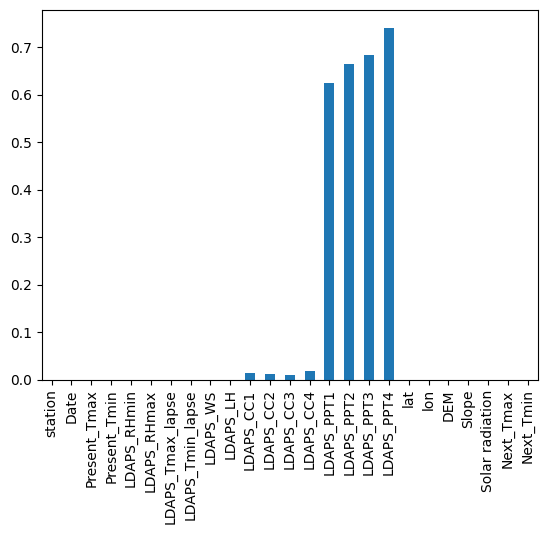

In [188]:
# Ratio of zeros in all columns
zero_ratios = (df == 0).mean()

# Columns who have 10% or more of their values as zero
high_zero_columns = set(df.columns[zero_ratios >= 0.1])

zero_ratios.plot(kind='bar')
print(f'Columns who have >10% of the data as zeros are:\n{high_zero_columns}')

More than 60% of the LDAPS model forecast of the 4 split average precipitation values are zeros. This suggests that these 4 columns must be removed from the data. 

## Exploring Missing Values

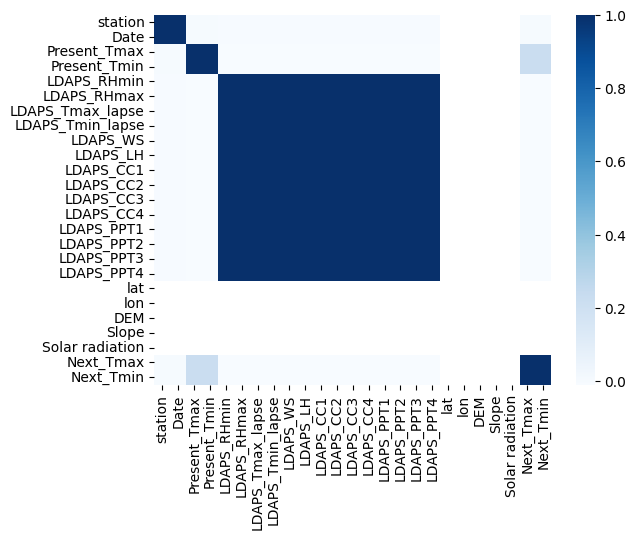

In [11]:
# Generate a heatmap for the correlation of the missing valus in the data
fig = sns.heatmap(df.isnull().corr(), cmap='Blues')

### Date and station

The Date and station columns have two missing values. The missing values correlation heatmap suggest that the missing values from both columns perfectly coincide with each other, however all the other variables have valid information for these two entities. Let's explore more to see where these missing values happen.

In [12]:
# The indices of the rows that have missing dates and stations
null_dates_rows = df[df['Date'].isnull()].index.to_list()
 
# The dates of the last 27 measurements 
last_27_dates = df.iloc[-27:]['Date'].value_counts()

print(f'The rows indices of the missing dates are: {null_dates_rows}, which are the last two rows\n')
print(f'The dates of the last 27 measurements are:\n{last_27_dates}')

The rows indices of the missing dates are: [7750, 7751], which are the last two rows

The dates of the last 27 measurements are:
2017-08-30    25
Name: Date, dtype: int64


The last 27 measurements contain only one date with 25 values. Hence, it is obvious that these missing information come from a new day for which only two measurements out of the 25 stations are available. This suggests the removal of these two entities. 

### In-situ Measurements & LDAPS Predictions 

The missing values correlation heatmap suggests that all the LDAPS missing values perfectly coincide with each other. The same is true for Present_Tmax & Present_Tmin (in-situ observations). However, missing values from in-situ observations and LDAPS predictions never coincide. 

Next it would be helpful to know from which dates and stations are these values missing to have a better understanding if there is a pattern in the nature of the missing values. 

In [13]:
# Dates which contain missing values for Present_Tmax and Present_Tmin
null_insitu_dates = df[df['Present_Tmax'].isnull()].groupby('Date').size()

# Stations which contain missing values for Present_Tmax and Present_Tmin
null_insitu_stations = df[df['Present_Tmax'].isnull()].groupby('station').size()

# Dates which contain missing values from the LDAPS model predictions
null_LDAPS_dates = df[df['LDAPS_Tmax_lapse'].isnull()].groupby('Date').size()

# Stations which contain missing values from the LDAPS model predictions
null_LDAPS_stations = df[df['LDAPS_Tmax_lapse'].isnull()].groupby('station').size()

print(f'The number of days that do not have in-situ observation values are: {null_insitu_dates.size}')
print(f'The number of stations that do not have in-situ observation values are: {null_insitu_stations.size}\n')

print(f'The number of days that do not have LDAPS prediction values are: {null_LDAPS_dates.size}')
print(f'The number of stations that do not have LDAPS prediction values are: {null_LDAPS_stations.size}')

The number of days that do not have in-situ observation values are: 56
The number of stations that do not have in-situ observation values are: 19

The number of days that do not have LDAPS prediction values are: 3
The number of stations that do not have LDAPS prediction values are: 25


The answer to the previous questions suggest that the missing in-situ measurements happen at random times from different stations. However, the missing LDAPS values are missing from only 3 days but from all the stations.

### Target Variables

The missing values heatmap shows that the missing values of both target variables coincide perfectly with each other. In addition, these missing values also correlate with the in-situ measurement values.

In [14]:
# Dates which contain missing target variables which don't coincide with missing in-situ measurements
null_target_dates = df[df['Next_Tmax'].isnull() & ~df['Present_Tmax'].isnull()].groupby('Date').size()

# Stations which contain missing target variables which don't coincide with missing in-situ measurements
null_target_stations = df[df['Next_Tmax'].isnull() & ~df['Present_Tmax'].isnull()].groupby('station').size()

print(f'The number of days that do not have target values are: {null_target_dates.size}')
print(f'The number of stations that do not have target values are: {null_target_stations.size}')

The number of days that do not have target values are: 16
The number of stations that do not have target values are: 11


## Exploring the Data Visually

### Correlation Matrix

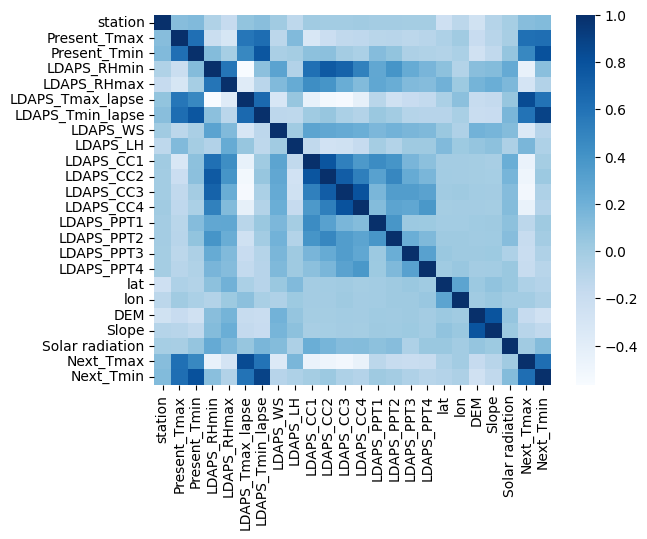

In [15]:
fig = sns.heatmap(df.corr(), cmap='Blues')

### Histograms

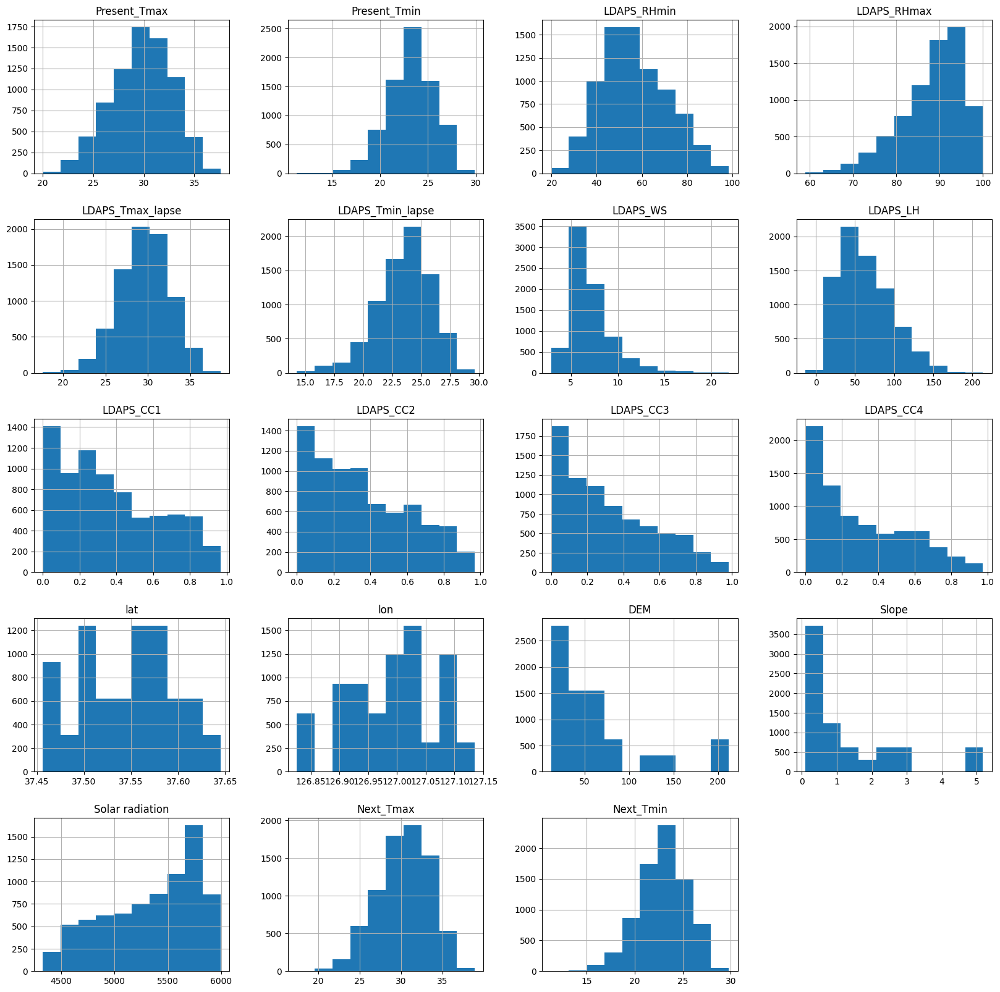

In [16]:
exclude_columns = ['station', 'LDAPS_PPT1', 'LDAPS_PPT2', 'LDAPS_PPT3', 'LDAPS_PPT4']
fig = df.loc[:, ~df.columns.isin(exclude_columns)].hist(figsize=(20,20))

### Years Bar Plot

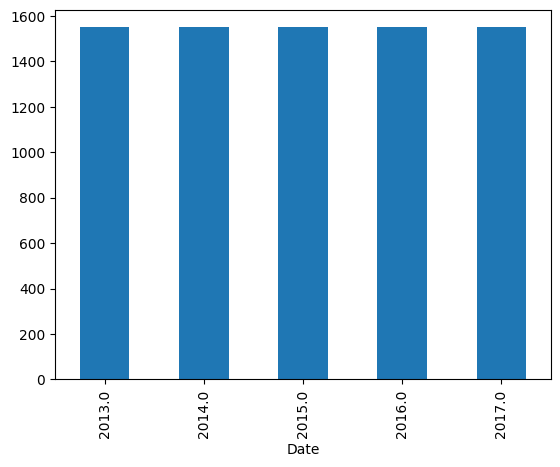

In [178]:
# Check the data distribution across the years
years = df.groupby(df['Date'].apply(pd.to_datetime).dt.year).size().plot(kind='bar')

### Months Bar Plot

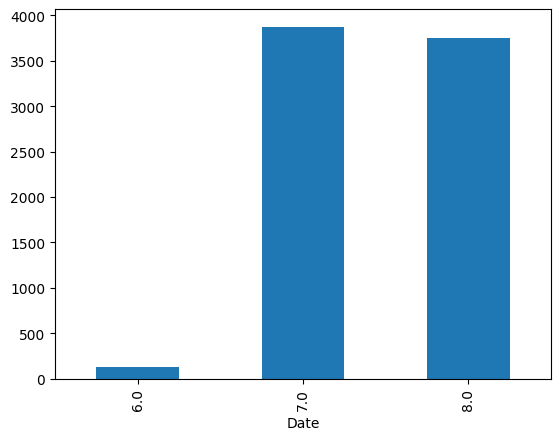

In [179]:
# Check the data distribution across the months
years = df.groupby(df['Date'].apply(pd.to_datetime).dt.month).size().plot(kind='bar')

## Coordinates Bar Plot

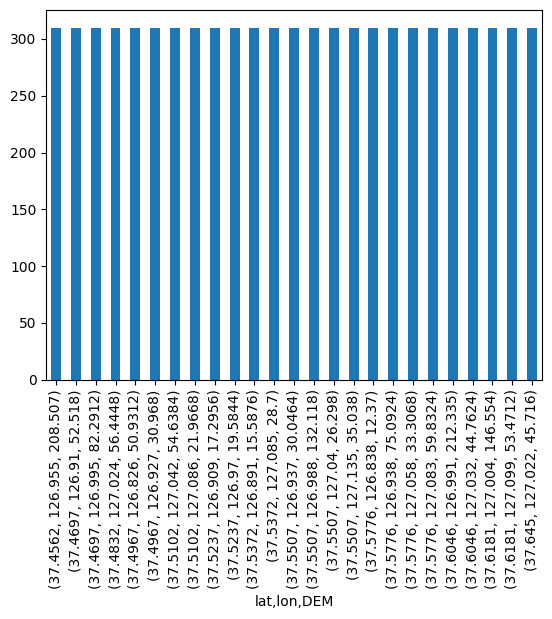

In [17]:
# Group by coordinates and remove the last two rows that contain missing station numbers
coordinates = df.iloc[:-2].groupby(['lat', 'lon', 'DEM']).size().plot(kind='bar')

The coordinates group into 25 groups that distribute unfifromly across the days, which means that one can use these coordinates to describe the location of the 25 stations. Hence, the station variable can be removed from the data and maybe used as an index.

# Data Preprocessing

In [191]:
def preprocess_data(df: pd.DataFrame) -> Tuple[pd.DataFrame, pd.DataFrame]:
    """Function that takes as input the raw data of Bias_correction_ucl.csv as a dataframe, 
    applies steps of preprcoessing and cleaning, then returns the independent and dependent (target) variables 
    in separate dataframes. 
    
    Preprocessing steps are:
        1. Remove the 4 LDAPS_PPT columns since they contain high proportion of zeros
        2. Remove the last two rows because they having missing data and station numbers
        3. Remove all rows that have missing target variables
        4. Remove all rows that have missing in-situ measurements
        5. Remove all rows that have missing LDAPS measurements
        6. Convert the data from string into datetime format, and the station from flot into int
        7. Set Date and station as a multi-index of the data and extract target variables
        
    Args:
        df: dataframe of the raw data
        
    Returns: X, y as independent and dependent variables, respectively
    
    """
    
    target_vars = ['Next_Tmin', 'Next_Tmax']
    
    # Step 1
    df = df.drop(df.columns[df.columns.str.contains('PPT')], axis=1)
    
    # Step 2
    df = df.iloc[:-2]
    
    # Step 3 - Step 5 can be done in one step since we are considering all the columns that have Null values
    df = df.dropna(axis=0, how='any')
    
    # Step 6
    df['Date'] = pd.to_datetime(df['Date'])
    df['station'] = df['station'].apply(int)
    
    # Step 7
    df = df.set_index(['Date', 'station'])
    
    X, y = df.drop(target_vars, axis=1), df[target_vars]
    
    return X, y

# Apply data preprocessing
X, y = preprocess_data(df)

# Data Validation

In [192]:
# Test the number of columns
assert len(X.columns) == 17 # 25 - 2(target variables) - 4(LDASP_PTT) - 2(Date & station)
assert len(y.columns) == 2 # Next_Tmin & Next_Tmax

# Test the number of rows
assert X.shape[0] == y.shape[0] 

# Test type of the Data index
assert type(X.index.get_level_values(0)) == pd.core.indexes.datetimes.DatetimeIndex

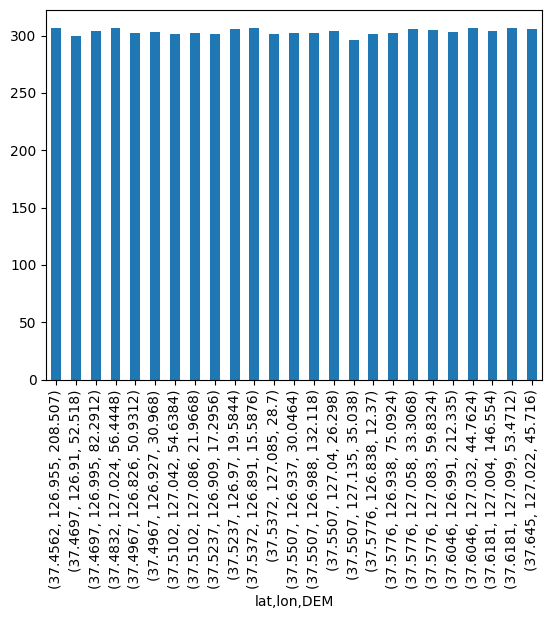

In [193]:
# Visualize the distribution of the station after removing Null
coordinates = X.iloc[:-2].groupby(['lat', 'lon', 'DEM']).size().plot(kind='bar')

The distribution of the stations after removing Null values is not uniform anymore. This means that there are different number of entities for each day present in the dataset. 

Some stations are represented more than the others. This needs to be taken in consideration when the evaluation results are interpreted. 

# Custom Validation Functions

In [209]:
class HindcastCV:
    """A class that implements Hincast validation across the years. 
    
    Unlike what is mentioned in the paper, this class applies Hindcast validation yearly, instead of daily. 
    The reason behind that is the need of a more efficient fuction in order to allow hyper-parameter tuning of
    the ML models. In additon, the nature of this data has a yearly pattern, which makes this function suitable
    for testing the generalization of the ML models across years. 
    
    This class has a generator that yields the train and test indices of different splits.

    """
    @classmethod
    def split(cls, X:pd.DataFrame):
        """This method generates indices of train and test sets after splitting the data into successive years.
        At each split, the train set contains measurements from the firt year until the year that meets
        the current split, wheras the test set contains measurment from the next year. 
        The last year is only included in the test set.
        
        The method assumes a pandas dataframe as input with a multi-index, where the first index is the
        date in the datetime format.
        
        Args:
            X: data of independent variables
        
        """
        
        # Find the group of years and the number of measurements for each year
        years_groups = X.groupby(X.index.get_level_values(0).year).size()
        
        # Accumlative train size increses with each split
        train_size = 0 
        
        for split, (year, year_size) in enumerate(years_groups.items()):
            train_size += year_size  # train_size - 1 = row index of last training sample
            
            train_idx = np.arange(train_size)  
            test_idx = np.where(X.index.get_level_values(0).year == year + 1)[0]
                    
            if split == len(years_groups) - 1:
                break
            
            yield train_idx, test_idx

            
class LOSOCV:
    """A class that implements Leave-One-Station-Out validation, which can be used to test the generalization
    of the ML models across different stations.
    
    This class implements a generator that yields the train and test indices of different splits.
    
    """
    
    @classmethod
    def split(cls, X:pd.DataFrame):
        """This method generates indices of train and test sets after splitting the data into different
        stations. At each split, the test set contains measurements from a unique station across all years, 
        whereas the train set contains the measurements from all other stations. 
        
        The method assumes a pandas dataframe as input with a multi-index, where the second index is the 
        station number.
        
        Args:
            X: data of independent variables 
        
        """
        
        # Find the group of stations and the number of measurements for each station
        stations_groups = X.groupby(X.index.get_level_values(1)).size()
        
        for station, _ in stations_groups.items():
            print(station)
            train_idx = np.where(X.index.get_level_values(1) != station)[0]
            test_idx = np.where(X.index.get_level_values(1) == station)[0]
            
            yield train_idx, test_idx

In [210]:
X

Present_Tmax  Present_Tmin  LDAPS_RHmin  LDAPS_RHmax  \
Date       station                                                         
2013-06-30 1                28.7          21.4    58.255688    91.116364   
           2                31.9          21.6    52.263397    90.604721   
           3                31.6          23.3    48.690479    83.973587   
           4                32.0          23.4    58.239788    96.483688   
           5                31.4          21.9    56.174095    90.155128   
...                          ...           ...          ...          ...   
2017-08-30 21               23.1          17.8    24.688997    78.261383   
           22               22.5          17.4    30.094858    83.690018   
           23               23.3          17.1    26.741310    78.869858   
           24               23.3          17.7    24.040634    77.294975   
           25               23.2          17.4    22.933014    77.243744   

                    LDAPS_Tmax_lapse  LDAPS_Tmin_lapse  LDAPS_WS    LDAPS_LH  \
Date       station                                                             
2013-06-30 1               28.074101         23.006936  6.818887   69.451805   
           2               29.850689         24.035009  5.691890   51.937448   
           3               30.091292         24.565633  6.138224   20.573050   
           4               29.704629         23.326177  5.650050   65.727144   
           5               29.113934         23.486480  5.735004  107.965535   
...                              ...               ...       ...         ...   
2017-08-30 21              27.812697         18.303014  6.603253    9.614074   
           22              26.704905         17.814038  5.768083   82.146707   
           23              26.352081         18.775678  6.148918   72.058294   
           24              27.010193         18.733519  6.542819   47.241457   
           25              27.939516         18.522965  7.289264    9.090034   

                    LDAPS_CC1  LDAPS_CC2     LDAPS_CC3  LDAPS_CC4      lat  \
Date       station                                                           
2013-06-30 1         0.233947   0.203896  1.616969e-01   0.130928  37.6046   
           2         0.225508   0.251771  1.594441e-01   0.127727  37.6046   
           3         0.209344   0.257469  2.040915e-01   0.142125  37.5776   
           4         0.216372   0.226002  1.611574e-01   0.134249  37.6450   
           5         0.151407   0.249995  1.788925e-01   0.170021  37.5507   
...                       ...        ...           ...        ...      ...   
2017-08-30 21        0.052902   0.030169  0.000000e+00   0.004380  37.5507   
           22        0.066461   0.024518  5.850000e-07   0.017678  37.5102   
           23        0.030034   0.081035  0.000000e+00   0.000000  37.5372   
           24        0.035874   0.074962  0.000000e+00   0.000000  37.5237   
           25        0.048954   0.059869  0.000000e+00   0.000796  37.5237   

                        lon       DEM   Slope  Solar radiation  
Date       station                                              
2013-06-30 1        126.991  212.3350  2.7850      5992.895996  
           2        127.032   44.7624  0.5141      5869.312500  
           3        127.058   33.3068  0.2661      5863.555664  
           4        127.022   45.7160  2.5348      5856.964844  
           5        127.135   35.0380  0.5055      5859.552246  
...                     ...       ...     ...              ...  
2017-08-30 21       127.040   26.2980  0.5721      4456.024414  
           22       127.086   21.9668  0.1332      4441.803711  
           23       126.891   15.5876  0.1554      4443.313965  
           24       126.909   17.2956  0.2223      4438.373535  
           25       126.970   19.5844  0.2713      4451.345215  

[7588 rows x 17 columns]

In [211]:
for train, test in LOSOCV.split(X):
    print(test)
    print(X.iloc[test])
    break

1
[   0   25   50   75  100  125  150  175  200  249  273  322  347  372
  397  422  470  495  520  545  570  595  620  644  669  694  719  744
  769  794  819  843  867  891  915  939  988 1013 1037 1061 1085 1110
 1135 1160 1185 1210 1235 1260 1285 1310 1335 1360 1385 1410 1435 1460
 1485 1510 1535 1560 1585 1610 1635 1660 1685 1710 1735 1760 1785 1810
 1835 1860 1885 1910 1935 1960 1985 2010 2035 2060 2085 2110 2135 2160
 2185 2210 2235 2260 2285 2310 2335 2360 2385 2410 2434 2458 2483 2508
 2533 2558 2583 2608 2633 2658 2683 2708 2733 2758 2783 2808 2833 2858
 2882 2907 2932 2957 2982 3007 3032 3057 3082 3107 3132 3157 3182 3207
 3232 3257 3282 3307 3332 3356 3381 3406 3431 3456 3481 3506 3531 3556
 3581 3606 3631 3655 3677 3701 3725 3750 3775 3800 3825 3849 3873 3898
 3923 3948 3973 3998 4022 4047 4072 4097 4122 4147 4169 4193 4217 4241
 4265 4290 4315 4340 4365 4390 4415 4440 4465 4490 4515 4540 4565 4590
 4615 4640 4665 4689 4714 4739 4764 4789 4814 4839 4864 4889 4914 4939
 496

In [195]:
years_groups = X.groupby(X.index.get_level_values(1)).size()
years_groups

station
1     303
2     307
3     306
4     306
5     296
6     301
7     301
8     300
9     302
10    307
11    301
12    302
13    305
14    303
15    302
16    304
17    307
18    307
19    302
20    304
21    304
22    302
23    307
24    302
25    307
dtype: int64

In [120]:
X.iloc[X.index.get_level_values(0).year == 2013]

Present_Tmax  Present_Tmin  LDAPS_RHmin  LDAPS_RHmax  \
Date       station                                                         
2013-06-30 1.0              28.7          21.4    58.255688    91.116364   
           2.0              31.9          21.6    52.263397    90.604721   
           3.0              31.6          23.3    48.690479    83.973587   
           4.0              32.0          23.4    58.239788    96.483688   
           5.0              31.4          21.9    56.174095    90.155128   
...                          ...           ...          ...          ...   
2013-08-30 21.0             28.3          23.9    35.730209    77.696594   
           22.0             29.7          24.0    40.317097    81.773575   
           23.0             29.4          23.8    47.522083    84.466637   
           24.0             28.5          23.9    43.959099    81.970146   
           25.0             28.6          24.3    38.598957    77.981155   

                    LDAPS_Tmax_lapse  LDAPS_Tmin_lapse  LDAPS_WS    LDAPS_LH  \
Date       station                                                             
2013-06-30 1.0             28.074101         23.006936  6.818887   69.451805   
           2.0             29.850689         24.035009  5.691890   51.937448   
           3.0             30.091292         24.565633  6.138224   20.573050   
           4.0             29.704629         23.326177  5.650050   65.727144   
           5.0             29.113934         23.486480  5.735004  107.965535   
...                              ...               ...       ...         ...   
2013-08-30 21.0            29.120528         22.124974  7.603857   14.416495   
           22.0            28.323008         22.165692  7.265069  102.554154   
           23.0            27.416718         21.413130  7.757029   94.591144   
           24.0            28.041749         21.617186  7.888563   49.817869   
           25.0            28.865053         22.228532  7.479918   20.790465   

                    LDAPS_CC1  LDAPS_CC2  LDAPS_CC3  LDAPS_CC4      lat  \
Date       station                                                        
2013-06-30 1.0       0.233947   0.203896   0.161697   0.130928  37.6046   
           2.0       0.225508   0.251771   0.159444   0.127727  37.6046   
           3.0       0.209344   0.257469   0.204091   0.142125  37.5776   
           4.0       0.216372   0.226002   0.161157   0.134249  37.6450   
           5.0       0.151407   0.249995   0.178892   0.170021  37.5507   
...                       ...        ...        ...        ...      ...   
2013-08-30 21.0      0.187049   0.147082   0.215294   0.312535  37.5507   
           22.0      0.213552   0.214911   0.172216   0.277677  37.5102   
           23.0      0.201947   0.252335   0.124413   0.249346  37.5372   
           24.0      0.210984   0.242769   0.167795   0.225992  37.5237   
           25.0      0.223916   0.227231   0.297848   0.259429  37.5237   

                        lon       DEM   Slope  Solar radiation  
Date       station                                              
2013-06-30 1.0      126.991  212.3350  2.7850      5992.895996  
           2.0      127.032   44.7624  0.5141      5869.312500  
           3.0      127.058   33.3068  0.2661      5863.555664  
           4.0      127.022   45.7160  2.5348      5856.964844  
           5.0      127.135   35.0380  0.5055      5859.552246  
...                     ...       ...     ...              ...  
2013-08-30 21.0     127.040   26.2980  0.5721      4456.024414  
           22.0     127.086   21.9668  0.1332      4441.803711  
           23.0     126.891   15.5876  0.1554      4443.313965  
           24.0     126.909   17.2956  0.2223      4438.373535  
           25.0     126.970   19.5844  0.2713      4451.345215  

[1510 rows x 17 columns]

In [72]:
tscv = TimeSeriesSplit(n_splits=1000)

for train_index, test_index in tscv.split(X):
    #print("TRAIN:", train_index, "TEST:", test_index)
    
    print(train_index[-1])
    break
    
X.iloc[588]

587


Present_Tmax          25.700000
Present_Tmin          24.500000
LDAPS_RHmin           65.092331
LDAPS_RHmax           95.850410
LDAPS_Tmax_lapse      27.388973
LDAPS_Tmin_lapse      23.390508
LDAPS_WS              12.308918
LDAPS_LH              51.777066
LDAPS_CC1              0.735397
LDAPS_CC2              0.499429
LDAPS_CC3              0.120306
LDAPS_CC4              0.261114
lat                   37.577600
lon                  126.938000
DEM                   75.092400
Slope                  1.767800
Solar radiation     5623.189941
Name: (2013-07-23 00:00:00, 19.0), dtype: float64

In [254]:
len(X[X.index.month == 8]) // 25

146

In [295]:
c = X.groupby('Date').size()

m = c.index[0]

print(m)

# evaluation
len(X[X.index == m])

# training
X.loc[c.index[0]:c.index[1]]

2013-06-30 00:00:00


,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,lat,lon,DEM,Slope,Solar radiation
Date,,,,,,,,,,,,,,,,,
2013-06-30,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,0.203896,0.161697,0.130928,37.6046,126.991,212.3350,2.7850,5992.895996
2013-06-30,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,0.251771,0.159444,0.127727,37.6046,127.032,44.7624,0.5141,5869.312500
2013-06-30,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,0.257469,0.204091,0.142125,37.5776,127.058,33.3068,0.2661,5863.555664
2013-06-30,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,0.226002,0.161157,0.134249,37.6450,127.022,45.7160,2.5348,5856.964844
2013-06-30,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,0.249995,0.178892,0.170021,37.5507,127.135,35.0380,0.5055,5859.552246
2013-06-30,31.9,23.5,52.437126,85.307251,29.219342,23.822613,6.182295,50.231389,0.185279,0.280818,0.232841,0.146363,37.5102,127.042,54.6384,0.1457,5873.780762
2013-06-30,31.4,24.4,56.287189,81.019760,28.551859,24.238467,5.587135,125.110007,0.389600,0.333570,0.270419,0.145705,37.5776,126.838,12.3700,0.0985,5849.233398
2013-06-30,32.1,23.6,52.326218,78.004539,28.851982,23.819054,6.104417,42.011547,0.357856,0.344928,0.272387,0.143841,37.4697,126.910,52.5180,1.5629,5863.992188
2013-06-30,31.4,22.0,55.338791,80.784607,28.426975,23.332373,6.017135,85.110971,0.408766,0.344800,0.264980,0.148911,37.4967,126.826,50.9312,0.4125,5876.901367


In [333]:
c = X.groupby('Date').size()
print(len(c))

lc = c.loc[c.index.year.isin([2013,2014])]
print(len(lc))

su = lc.sum()
print(su)

X.iloc[0:su]

X.iloc[:su+c[123]]

X.iloc[:su+c[123]+c[124]]


307
123
3057


,Present_Tmax,Present_Tmin,LDAPS_RHmin,LDAPS_RHmax,LDAPS_Tmax_lapse,LDAPS_Tmin_lapse,LDAPS_WS,LDAPS_LH,LDAPS_CC1,LDAPS_CC2,LDAPS_CC3,LDAPS_CC4,lat,lon,DEM,Slope,Solar radiation
Date,,,,,,,,,,,,,,,,,
2013-06-30,28.7,21.4,58.255688,91.116364,28.074101,23.006936,6.818887,69.451805,0.233947,0.203896,0.161697,0.130928,37.6046,126.991,212.3350,2.7850,5992.895996
2013-06-30,31.9,21.6,52.263397,90.604721,29.850689,24.035009,5.691890,51.937448,0.225508,0.251771,0.159444,0.127727,37.6046,127.032,44.7624,0.5141,5869.312500
2013-06-30,31.6,23.3,48.690479,83.973587,30.091292,24.565633,6.138224,20.573050,0.209344,0.257469,0.204091,0.142125,37.5776,127.058,33.3068,0.2661,5863.555664
2013-06-30,32.0,23.4,58.239788,96.483688,29.704629,23.326177,5.650050,65.727144,0.216372,0.226002,0.161157,0.134249,37.6450,127.022,45.7160,2.5348,5856.964844
2013-06-30,31.4,21.9,56.174095,90.155128,29.113934,23.486480,5.735004,107.965535,0.151407,0.249995,0.178892,0.170021,37.5507,127.135,35.0380,0.5055,5859.552246
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2015-07-01,27.3,21.5,26.437294,86.321739,29.348962,20.675390,8.981307,14.981451,0.072509,0.271860,0.056151,0.000000,37.5507,127.040,26.2980,0.5721,5853.975098
2015-07-01,26.3,20.2,30.032558,90.755737,28.416413,20.062254,8.194299,103.181338,0.074992,0.233841,0.046610,0.000144,37.5102,127.086,21.9668,0.1332,5847.513184
2015-07-01,28.0,21.8,34.579773,89.513321,27.450152,20.586566,8.057371,90.842910,0.016264,0.287606,0.049076,0.000232,37.5372,126.891,15.5876,0.1554,5846.012695


In [297]:
c

Date
2013-06-30    25
2013-07-01    25
2013-07-02    25
2013-07-03    25
2013-07-04    25
              ..
2017-08-26    24
2017-08-27    25
2017-08-28    24
2017-08-29    24
2017-08-30    25
Length: 307, dtype: int64